In [ ]:
#default_exp data

The first thing we need to do is download the data.

First of all, let's install the [kaggle api](https://github.com/Kaggle/kaggle-api) and configure it with [API credentials](https://github.com/Kaggle/kaggle-api#api-credentials).

Let's create a folder to download the competition files.

In [1]:
mkdir data

Let's download the files now (make sure you accept competition rules on Kaggle first or else you will not be able to access the data!).

In [2]:
!kaggle competitions download birdsong-recognition -p data

100%|█████████████████████████████████████▉| 22.1G/22.1G [06:45<00:00, 83.2MB/s]
100%|██████████████████████████████████████| 22.1G/22.1G [06:45<00:00, 58.5MB/s]


In [3]:
!ls data

birdsong-recognition.zip


In [6]:
%%capture
!unzip data/birdsong-recognition.zip -d data

In [7]:
!ls data

birdsong-recognition.zip	 example_test_audio_summary.csv  train_audio
example_test_audio		 sample_submission.csv		 train.csv
example_test_audio_metadata.csv  test.csv


Let's take a look at `train.csv`.

In [52]:
import pandas as pd

train = pd.read_csv('data/train.csv')
train.shape

(21375, 35)

In [2]:
train.head()

,rating,playback_used,ebird_code,channels,date,pitch,duration,filename,speed,species,...,xc_id,url,country,author,primary_label,longitude,length,time,recordist,license
0,3.5,no,aldfly,1 (mono),2013-05-25,Not specified,25,XC134874.mp3,Not specified,Alder Flycatcher,...,134874,https://www.xeno-canto.org/134874,United States,Jonathon Jongsma,Empidonax alnorum_Alder Flycatcher,-92.962,Not specified,8:00,Jonathon Jongsma,Creative Commons Attribution-ShareAlike 3.0
1,4.0,no,aldfly,2 (stereo),2013-05-27,both,36,XC135454.mp3,both,Alder Flycatcher,...,135454,https://www.xeno-canto.org/135454,United States,Mike Nelson,Empidonax alnorum_Alder Flycatcher,-82.1106,0-3(s),08:30,Mike Nelson,Creative Commons Attribution-NonCommercial-Sha...
2,4.0,no,aldfly,2 (stereo),2013-05-27,both,39,XC135455.mp3,both,Alder Flycatcher,...,135455,https://www.xeno-canto.org/135455,United States,Mike Nelson,Empidonax alnorum_Alder Flycatcher,-82.1106,0-3(s),08:30,Mike Nelson,Creative Commons Attribution-NonCommercial-Sha...
3,3.5,no,aldfly,2 (stereo),2013-05-27,both,33,XC135456.mp3,both,Alder Flycatcher,...,135456,https://www.xeno-canto.org/135456,United States,Mike Nelson,Empidonax alnorum_Alder Flycatcher,-82.1106,0-3(s),08:30,Mike Nelson,Creative Commons Attribution-NonCommercial-Sha...
4,4.0,no,aldfly,2 (stereo),2013-05-27,both,36,XC135457.mp3,level,Alder Flycatcher,...,135457,https://www.xeno-canto.org/135457,United States,Mike Nelson,Empidonax alnorum_Alder Flycatcher,-82.1106,0-3(s),08:30,Mike Nelson,Creative Commons Attribution-NonCommercial-Sha...


In [53]:
classes = train.ebird_code.unique().tolist()
len(classes)

264

We can listen to the longest recording in the train set:

In [3]:
from IPython.lib.display import Audio

Audio('data/train_audio/comrav/XC246425.mp3')

How many different birds are there in the train set?

In [29]:
train.ebird_code.nunique()

264

This is what sampling rates across the recordings look like:

In [24]:
train.sampling_rate.value_counts()

44100 (Hz)    12693
48000 (Hz)     8373
22050 (Hz)      123
32000 (Hz)       93
24000 (Hz)       54
16000 (Hz)       34
11025 (Hz)        3
8000 (Hz)         2
Name: sampling_rate, dtype: int64

One of the organizers shared [on Kaggle](https://www.kaggle.com/c/birdsong-recognition/discussion/159943#893049) that all the recordings in the test set should be sampled at 32 kHz.

Let's resample the train set to 32 kHz to perform this comptuationally expensive operation only once before training.

**!!! WARNING !!!**

The code below was run on a 96 vCpu vm - this might take a really long time on a standard machine. To save you the hassle I uploaded the data post transformation onto GCP storage [here](https://storage.googleapis.com/birdcall_competition/train_resampled.zip). The files are zipped so you will have to extract them after download completes.

In [1]:
#export

import soundfile as sf
from pathlib import Path
import librosa
import numpy as np
from multiprocessing import Pool, cpu_count
import pandas as pd

import warnings
warnings.filterwarnings("ignore", category=UserWarning)

In [14]:
mkdir data/train_resampled

In [23]:
import os

for directory in Path('data/train_audio').iterdir():
    ebird_code = directory.name
    os.makedirs(f'data/train_resampled/{ebird_code}')

In [14]:
#export
NUM_WORKERS = cpu_count()
SAMPLE_RATE = 32_000

In the course of processing the files I found that I cannot read `data/train_audio/lotduc/XC195038.mp3`. Removing it to not get an error.

In [14]:
Path('data/train_audio/lotduc/XC195038.mp3').unlink()

In [3]:
def resample_audio(path):
    x = librosa.load(path, sr=SAMPLE_RATE, mono=True)[0]
    ebird_code = path.parent.name
    sf.write(f'data/train_resampled/{ebird_code}/{path.stem}.wav', x, SAMPLE_RATE)

In [ ]:
%%time
for directory in Path('data/train_audio').iterdir():
    file_paths = list(directory.iterdir())
    with Pool(NUM_WORKERS // 2) as p:
        p.map(resample_audio, file_paths)

Ok, so we now have all the audio saved in a convenient format and we offloaded the expensive resampling to happen before training. Great!

The big question is - how many recordings do we have per species?

In [6]:
%%time
from collections import defaultdict

recs = defaultdict(list)
for directory in Path('data/train_resampled').iterdir():
    ebird_code = directory.name
    for file in directory.iterdir():
        recs[ebird_code].append((file, sf.info(file).duration))

CPU times: user 1.32 s, sys: 336 ms, total: 1.66 s
Wall time: 1.75 s


In [99]:
counts = [len(recs[ebird]) for ebird in recs.keys()]
min(counts), max(counts)

(9, 100)

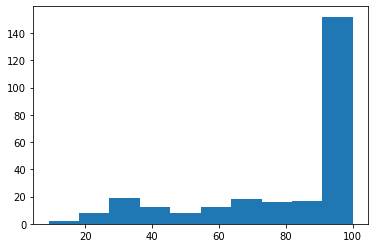

In [100]:
import matplotlib.pyplot as plt

plt.hist(counts);

In [101]:
(np.array(counts) == 100).sum()

134

As it turns out, we have between 9 and 100 recordings per ebird code. Let's construct the train and validation sets taking this into account.

In [54]:
train, val = {}, {}

for ebird in recs.keys():
    rs = recs[ebird]
    val_count = max(int(len(rs) * 0.1), 1)

    val[ebird] = rs[:val_count]
    train[ebird] = rs[val_count:]

In [50]:
#export

from torch.utils.data import Dataset

class AudioDataset(Dataset):
    def __init__(self, recs, classes, len_mult=20, mean=None, std=None):
        self.recs = recs
        self.vocab = classes
        self.do_norm = (mean and std)
        self.mean = mean
        self.std = std
        self.len_mult = len_mult
    def __getitem__(self, idx):
        cls_idx = idx % len(self.vocab)
        recs = self.recs[classes[cls_idx]]
        path, duration = recs[np.random.randint(0, len(recs))]
        if duration > 5:
            x, _ = sf.read(path, start=int(np.random.rand() * (duration-5) * SAMPLE_RATE), frames=5*SAMPLE_RATE)
#             x, _ = librosa.load(path, sr=None, duration=5, offset=np.random.rand() * (duration-5))
        else:
            # this branch of the if condition is slow - I suspect due to np.tile? might want to
            # revisit what we do here down the road, also - it would probably be better to not repeat the signal
            # but rather embed it in some appropriate and longer environment sound
            # on the other hand this branch is not triggered very often so that maybe is not that big of a problem
            x, _ = sf.read(path)
#             x, _ = librosa.load(path, sr=None)
            x =  np.tile(x, 15) # the shortest rec in the train set is 0.39 sec
            start_frame = int(np.random.rand() * (x.shape[0] - 5 * SAMPLE_RATE))
            x = x[start_frame:start_frame+5*SAMPLE_RATE]
        if x.shape[0] != 5 * SAMPLE_RATE: raise Exception(f'Incorrect length: {x.shape[0]}, {path}, {duration}')
        if self.do_norm: x = self.normalize(x)
        return x.astype(np.float32), self.one_hot_encode(cls_idx)
    def normalize(self, x):
        return (x - self.mean) / self.std
    def one_hot_encode(self, y):
        one_hot = np.zeros((len(self.vocab)))
        one_hot[y] = 1
        return one_hot
    def __len__(self):
        return self.len_mult * len(self.vocab)

In [55]:
pd.to_pickle(classes, 'data/classes.pkl')
pd.to_pickle(train, 'data/train_set.pkl')
pd.to_pickle(val, 'data/val_set.pkl')
pd.to_pickle(recs, 'data/recs.pkl')

In [56]:
classes = pd.read_pickle('data/classes.pkl')
train_ds = AudioDataset(pd.read_pickle('data/train_set.pkl'), classes)
valid_ds = AudioDataset(pd.read_pickle('data/val_set.pkl'), classes, len_mult=10)

In [26]:
%%time
x = []
for i in range(264*20):
    x.append(train_ds[i][0])

CPU times: user 3.01 s, sys: 1.24 s, total: 4.25 s
Wall time: 17.6 s


In [27]:
np.stack(x).mean(), np.stack(x).std()

(1.6537946e-05, 0.04572224)

In [132]:
#export
classes = pd.read_pickle('data/classes.pkl')
train_ds = AudioDataset(pd.read_pickle('data/train_set.pkl'), classes, mean=1.6537946e-05, std=0.04572224)
valid_ds = AudioDataset(pd.read_pickle('data/val_set.pkl'), classes, len_mult=10, mean=1.6537946e-05, std=0.04572224)

Seems we have everything we need now to start training!

(someone could comment having a non-deterministic validation set is generally not a good idea, but I think we can live with this for now).